# S02_EDA

In [ ]:
import pandas as pd
import numpy as np
from datetime import datetime
import seaborn as sns
import matplotlib.pyplot as plt
from time import time
from shutil import copyfile
import zipfile
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.dates as mdates
import plotly.express as px

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
source_path = "/content/drive/MyDrive/marketing analytics/file aggiornati.zip"

We have 7 csv files in the zip, their filenames are:
*  **tbl_addresses**: contains info on address corresponding to a customer account
*  **tbl_customer_accounts**: contains info on the loyalty account associated to the customers
* **tbl_customer_reviews**: contains the reviews made by the customers
* **tbl_customers**: contains info on the customers
*  **tbl_labelled_reviews**: contains a set of review texts with the sentiment labels assigned (ground-truth)
* **tbl_orders**: contains all the orders made by the customers, i.e. all the products purchased or refunded by the
customers
* **tbl_products**: contains the info on the products



# CSV File: "tbl_addresses"


*   address_id: Identify address (key)
*   postal_code: Postal code of the address
*   district: Province/district of the address
*   region: Region of the address

Concerning the handling of missing values, it was decided to convert NaN values to 0 in order to perform certain operations on the numerical values

In [ ]:
# Extract file: tbl_addresses
t0 = time()
with zipfile.ZipFile(source_path, 'r') as zip:
    zip.extract('tbl_addresses.csv')
print("File extraction completed in %0.3f seconds" % (time() - t0))

File extraction completed in 1.594 seconds


In [ ]:
# File path of the extracted 'tbl_addresses.csv' filE
csv_file_path = "tbl_addresses.csv"

# Read CSV file, treating empty cells as NaN and replace them with 0
tbl_addresses = pd.read_csv(csv_file_path)

In [ ]:
tbl_addresses

,Unnamed: 0,address_id,postal_code,district,region,clean_district
0,0,1337,20083,MI,LOMBARDIA,MI
1,1,1347,20090,MI,LOMBARDIA,MI
2,5,1387,20084,MI,LOMBARDIA,MI
3,6,1412,20090,MI,LOMBARDIA,MI
4,10,1418,20147,MI,LOMBARDIA,MI
...,...,...,...,...,...,...
157760,245415,824736,24040,BG,LOMBARDIA,BG
157761,245416,149079,20158,MI,LOMBARDIA,MI
157762,245419,484639,95100,CT,SICILIA,CT
157763,245421,651219,35030,PD,VENETO,PD


In [ ]:
tbl_addresses= tbl_addresses.loc[:, ~tbl_addresses.columns.isin(['Unnamed: 0','district'])]


In [ ]:
ok =  tbl_addresses[~tbl_addresses['region'].isin(['VATICANO', '0', 'ESTERO'])].groupby('region').agg(count=('region', 'size')).reset_index()

def custom_title(region):
    exceptions = {
        "TRENTINO ALTO ADIGE": "Trentino-Alto Adige",
        "VALLE D'AOSTA": "Valle d'Aosta",
       'EMILIA ROMAGNA' :'Emilia-Romagna'
    }

    if region in exceptions:
        return exceptions[region]

    return region.title()

# Applica la funzione alla colonna "region" del DataFrame
ok ["region"] = ok ["region"].apply(custom_title)
ok

,region,count
0,Abruzzo,3252
1,Basilicata,466
2,Calabria,491
3,Campania,12894
4,Emilia-Romagna,9610
5,Friuli Venezia Giulia,2785
6,Lazio,20281
7,Liguria,3951
8,Lombardia,47506
9,Marche,612


In [ ]:
import plotly.express as px
import requests
import os
import geopandas as gpd
import fiona
from shapely.geometry import Polygon

In [ ]:
# Specify the path to the ZIP archive
source_path = "/content/drive/MyDrive/marketing analytics/shp.distretti.zip"

# Destination directory to extract the shapefiles
extract_dir = "/content/extracted_shapefiles"

# Create the destination directory if it doesn't exist
os.makedirs(extract_dir, exist_ok=True)

# Open the ZIP archive
with zipfile.ZipFile(source_path, 'r') as zip_ref:
    # Extract all files to the destination directory
    zip_ref.extractall(path=extract_dir)

In [ ]:
# Corrected path to the extracted shapefile directory
shapefile_dir = "/content/extracted_shapefiles"
# Read the shapefile using geopandas
gdf = gpd.read_file(shapefile_dir)

In [ ]:
merged_gdf.sort_values(by= 'count', ascending=False)

,COD_RIP,COD_REG,DEN_REG,Shape_Leng,Shape_Area,geometry,region,count
2,1,3,Lombardia,1.410223e+06,2.386232e+10,"MULTIPOLYGON (((485536.366 4985444.605, 485366...",Lombardia,47506
11,3,12,Lazio,1.054411e+06,1.722682e+10,"MULTIPOLYGON (((875952.995 4524692.050, 875769...",Lazio,20281
4,2,5,Veneto,1.054587e+06,1.834355e+10,"POLYGON ((768123.960 5175397.497, 768135.210 5...",Veneto,14180
14,4,15,Campania,8.881667e+05,1.366325e+10,"MULTIPOLYGON (((1037313.692 4449410.367, 10373...",Campania,12894
0,1,1,Piemonte,1.236800e+06,2.539388e+10,"POLYGON ((457749.464 5145501.795, 458662.395 5...",Piemonte,11754
18,5,19,Sicilia,1.337060e+06,2.582375e+10,"MULTIPOLYGON (((822886.611 3935355.889, 822871...",Sicilia,10796
7,2,8,Emilia-Romagna,1.180343e+06,2.249987e+10,"MULTIPOLYGON (((618343.929 4893985.661, 618335...",Emilia-Romagna,9610
15,4,16,Puglia,1.176879e+06,1.953567e+10,"MULTIPOLYGON (((1280636.111 4454459.746, 12806...",Puglia,8798
8,3,9,Toscana,1.306243e+06,2.298404e+10,"MULTIPOLYGON (((674426.642 4680710.364, 674563...",Toscana,6228
6,1,7,Liguria,8.196598e+05,5.414542e+09,"MULTIPOLYGON (((568226.691 4874823.573, 568219...",Liguria,3951


## Region

In [ ]:
merged_gdf = gdf.merge(ok, left_on='DEN_REG', right_on='region')


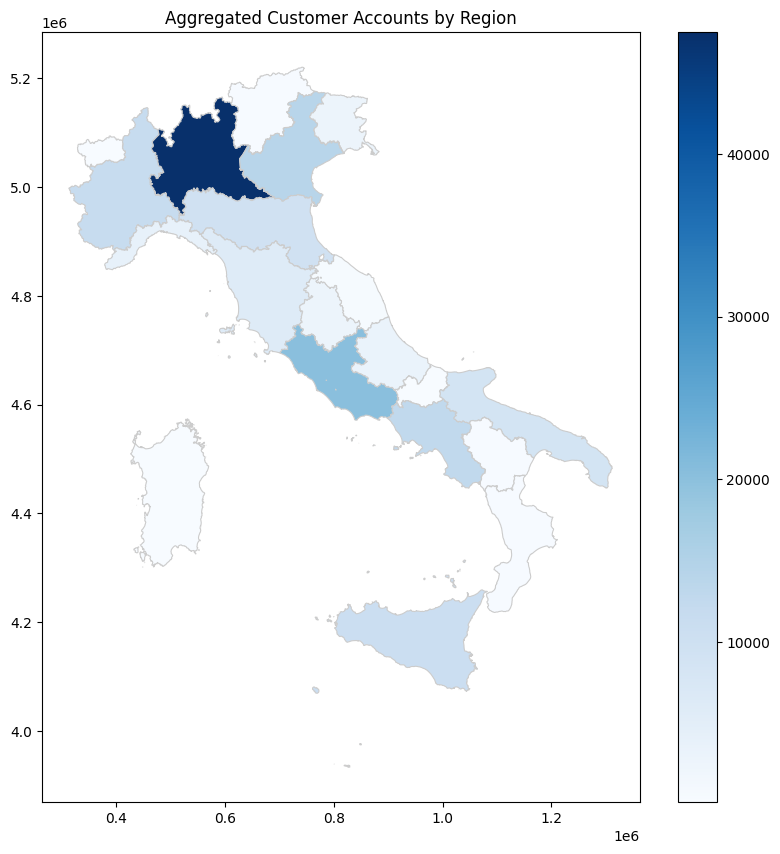

In [ ]:
# Plot the shapefile with colors based on the 'count' column
fig, ax = plt.subplots(figsize=(10, 10))
merged_gdf.plot(column='count', cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8', legend=True)


ax.set_title("Aggregated Customer Accounts by Region")

plt.show()

## District

In [ ]:
oks =  tbl_addresses[~tbl_addresses['region'].isin(['VATICANO', '0', 'ESTERO'])].groupby('clean_district').agg(count=('clean_district', 'size')).reset_index()


In [ ]:
# Specify the path to the ZIP archive
source_paths = "/content/drive/MyDrive/marketing analytics/shp.province.zip"

# Destination directory to extract the shapefiles
extract_dirs = "/content/extracted_shapefiless"

# Create the destination directory if it doesn't exist
os.makedirs(extract_dirs, exist_ok=True)

# Open the ZIP archive
with zipfile.ZipFile(source_paths, 'r') as zip_ref:
    # Extract all files to the destination directory
    zip_ref.extractall(path=extract_dirs)

# Corrected path to the extracted shapefile directory
shapefile_dirs = "/content/extracted_shapefiless"
# Read the shapefile using geopandas
gdfs = gpd.read_file(shapefile_dirs)

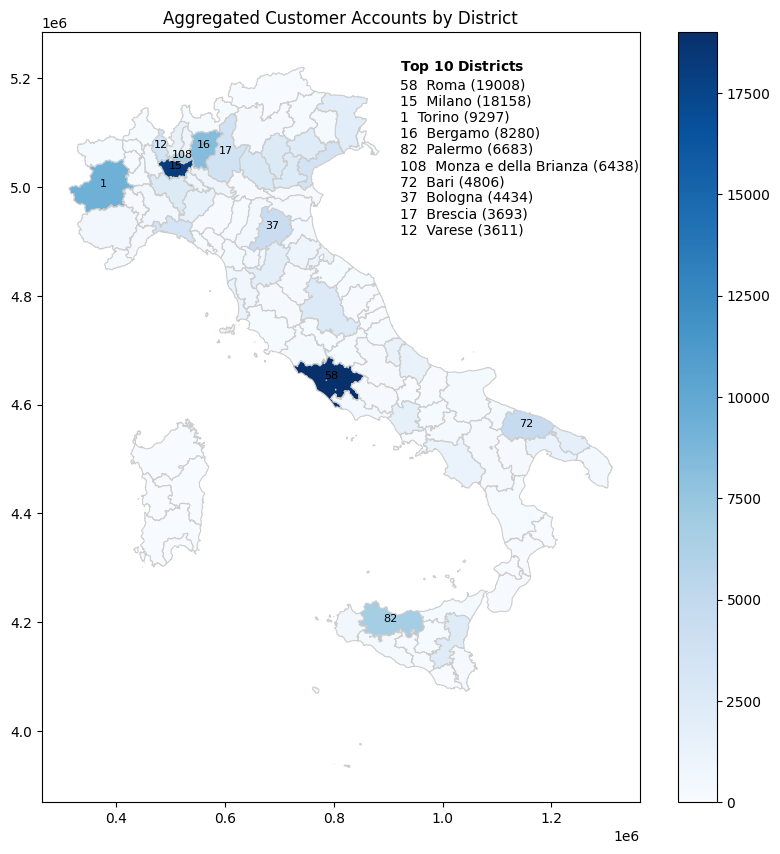

In [ ]:
merged_gdfs = gdfs.merge(oks, left_on='SIGLA', right_on='clean_district', how='left')
# Fill NaN values in the "count" column with 0
merged_gdfs['count'] = merged_gdfs['count'].fillna(0)

# Convert the 'count' column to integer data type
merged_gdfs['count'] = merged_gdfs['count'].astype(int)
# Plot the shapefile with colors based on the 'count' column
fig, ax = plt.subplots(figsize=(10, 10))
plot = merged_gdfs.plot(column='count', cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8', legend=True)
#top10 districts
top_10_districts = merged_gdfs.sort_values(by="count", ascending=False).iloc[:10]
# Add COD_PROV labels for the first 10 districts with high counts
for idx, row in top_10_districts.iterrows():
    ax.text(row['geometry'].centroid.x, row['geometry'].centroid.y, str(row['COD_PROV']), ha='center', fontsize=8, color='black')


# Customize the legend with the names of the top 10 districts
legend_labels = top_10_districts['DEN_UTS']

# Set the legend labels and corresponding numbers using the provided ax.text() code
legend_texts = []
# Add the title for the top 10 districts
legend_texts.append(r"$\bf{Top\ 10\ Districts}$")  # Bold title
for idx, row in top_10_districts.iterrows():
    legend_texts.append(f"{row['COD_PROV']}  {row['DEN_UTS']} ({row['count']}) ")
legend_text = '\n'.join(legend_texts)

# Add the legend text to the plot
ax.text(0.60, 0.85, legend_text, horizontalalignment='left', verticalalignment='center', transform=ax.transAxes, fontsize=10)

ax.set_title("Aggregated Customer Accounts by District")
plt.show()

# CSV File: "tbl_customers"



*  **customer_id**: Identify the
customer
(key)
*  **address_id**: Identify address
(foreign key)
*  **birthdate**: Date of birth of the
customer
*  **gender**: Customer gender,
if provided by the
customer
* **job_type**: Customer job, if
provided by the
customer
* **email_provider**: Provider of the
email account
provided by the
customer
* **flag_phone_provided**: True/False if the
customer provide
the phone number
* **flag_privacy**: True/False if the
customer accepts
privacy terms





In [ ]:
# Extract file: tbl_addresses
t0 = time()
with zipfile.ZipFile(source_path, 'r') as zip:
    zip.extract('tbl_customers.csv')
print("File extraction completed in %0.3f seconds" % (time() - t0))

File extraction completed in 1.172 seconds


In [ ]:
# File path of the extracted 'tbl_customers.csv' file
csv_file_path = "tbl_customers.csv"
tbl_customers = pd.read_csv(csv_file_path)

In [ ]:
tbl_customers

,Unnamed: 0,customer_id,address_id,birthdate,gender,job_type,email_provider,flag_phone_provided,flag_privacy,genders,Age,age_group
0,0,891057,863914,2001-10-22,F,NaN,yahoo.it,1,True,0,21,18-25
1,1,655484,639856,2001-04-30,M,NaN,yahoo.it,1,False,1,21,18-25
2,2,514958,494806,2001-01-01,M,NaN,libero.it,1,True,1,22,18-25
3,3,398355,377261,2000-03-09,M,NaN,gmail.com,1,True,1,22,18-25
4,4,23808,20227,1999-11-21,F,NaN,virgilio.it,1,True,0,23,18-25
...,...,...,...,...,...,...,...,...,...,...,...,...
140941,140941,449222,428121,1945-05-30,F,NaN,libero.it,1,True,0,77,76-85
140942,140942,368113,346970,1943-11-18,F,NaN,yahoo.com,1,True,0,79,76-85
140943,140943,424451,403292,1943-05-07,F,NaN,gmail.com,1,True,0,79,76-85
140944,140944,808137,789737,1943-02-13,F,NaN,yahoo.it,1,True,0,79,76-85


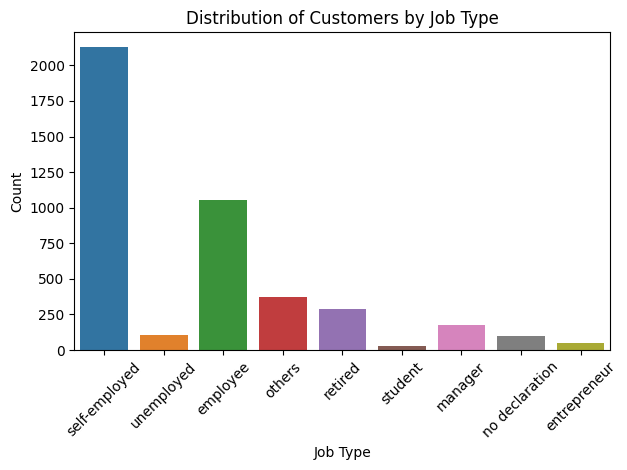

In [ ]:
# Create the countplot  (job type abbiamo pochissimi dati. Porta ad un'analisi)
sns.countplot(x='job_type', data=tbl_customers)

# Customize the plot if needed
plt.xlabel('Job Type')
plt.ylabel('Count')
plt.title('Distribution of Customers by Job Type')
plt.xticks(rotation=45)

# Display the plot
plt.tight_layout()
plt.show()

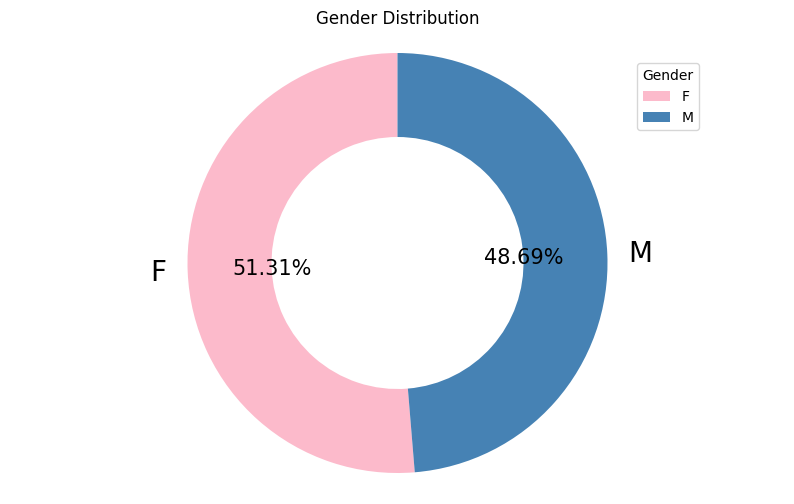

In [ ]:
label_cal =tbl_customers['gender'].value_counts(sort = True).index
size_cal= tbl_customers['gender'].value_counts(sort = True)

# Create a figure with a pie chart at the center and a white circle in the middle for the donut effect
fig, ax = plt.subplots(figsize=(10, 6))
centre_circle = plt.Circle((0, 0), 0.70, fc='white')
fig.gca().add_artist(centre_circle)

# Create a pie chart with a donut effect
wedges, texts, autotexts = ax.pie(size_cal, labels=label_cal, autopct='%1.2f%%', startangle=90, colors=['#FCBACB','#4682B4'], wedgeprops=dict(width=0.4))

# Equal aspect ratio ensures that pie is drawn as a circle.
ax.axis('equal')
# Customize text properties of labels inside the chart
for text in texts:
    text.set_fontsize(20)

# Customize text properties of autopct labels
for autotext in autotexts:
    autotext.set_fontsize(15)

# Add a legend
ax.legend(wedges, label_cal, title='Gender', loc="center left", bbox_to_anchor=(0.8, 0.41, 0.7, 0.9))

plt.title('Gender Distribution')
plt.show()

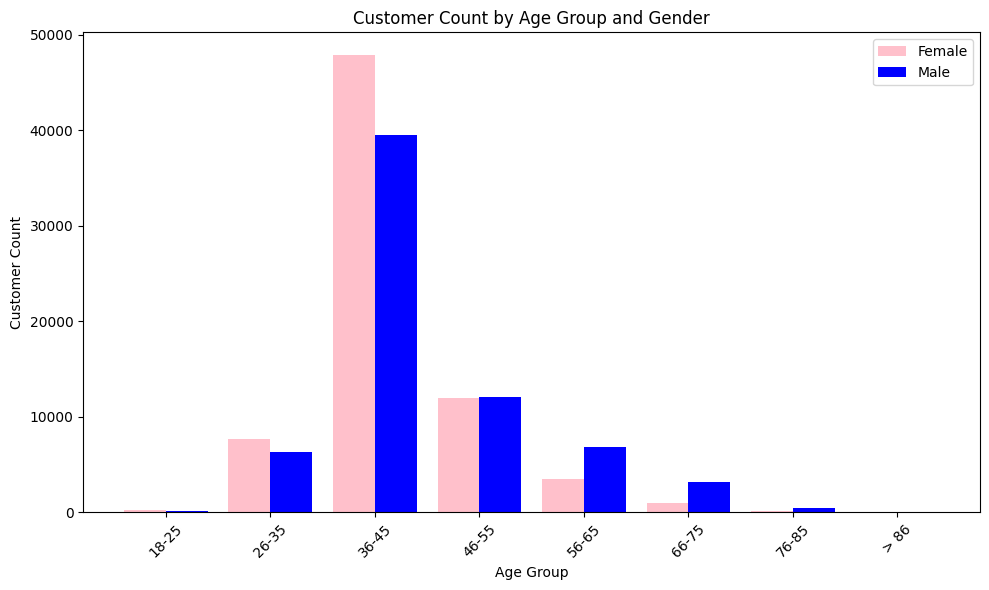

In [ ]:
male= tbl_customers[tbl_customers['gender']== 'M']
female= tbl_customers[tbl_customers['gender']== 'F']

male= male.pivot_table(index='age_group', values='customer_id', aggfunc='count')
female= female.pivot_table(index='age_group', values='customer_id', aggfunc='count')

oks= pd.merge( female, male, on='age_group',  suffixes=('_female', '_male') )
# Set the figure size
plt.figure(figsize=(10, 6))

# Calculate the bar positions
bar_width = 0.4
bar_positions_female = range(len(oks))
bar_positions_male = [pos + bar_width for pos in bar_positions_female]

# Plotting the bars
plt.bar(bar_positions_female, oks['customer_id_female'], label='Female', width=bar_width, color='pink')
plt.bar(bar_positions_male, oks['customer_id_male'], label='Male', width=bar_width, color='blue')

# Adding x-axis labels and title
plt.xlabel('Age Group')
plt.ylabel('Customer Count')
plt.title('Customer Count by Age Group and Gender')

# Adjust x-axis tick positions and labels
plt.xticks([pos + bar_width / 2 for pos in bar_positions_female], oks.index, rotation=45)

# Add legend
plt.legend()

# Display the plot
plt.tight_layout()
plt.show()

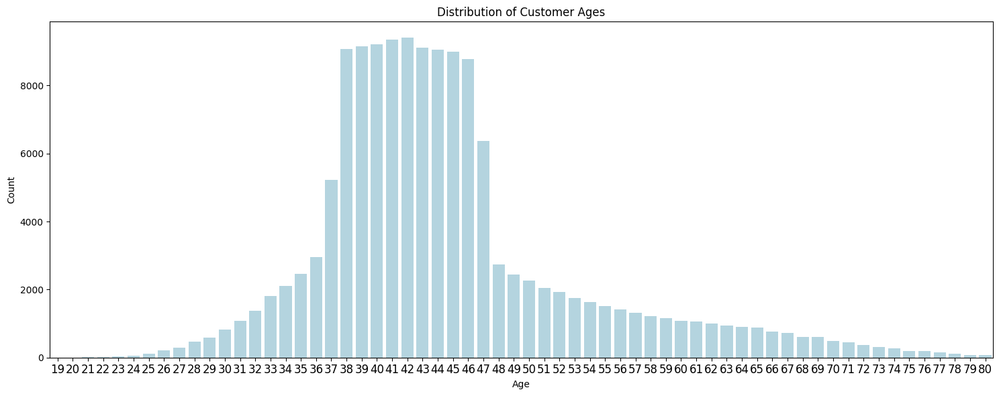

In [ ]:
# Filter out ages greater than 80
filtered_data = tbl_customers[tbl_customers["Age"] <= 80]
# Group by age and calculate the count of occurrences
age_counts = filtered_data.groupby("Age").size().reset_index(name="Count")
# Set the figure size
plt.figure(figsize=(15, 6))
# Create the histogram plot using Seaborn
sns.barplot(data=age_counts, x='Age', y='Count', color='lightblue')

# Customize the plot
plt.xlabel('Age')
plt.ylabel('Count')
plt.title('Distribution of Customer Ages')
plt.xticks(fontsize=12)
# Display the plot
plt.tight_layout()
plt.show()


In [ ]:
tbl_customers= tbl_customers.loc[:, ~tbl_customers.columns.isin(['Unnamed: 0','birthdate','genders','flag_phone_provided', 'flag_privacy'])]

# CSV File: "tbl_customer_accounts"




*  **customer_id**: Identify the customer
(foreign key)
*   **account_id**: Identify the customer’s
loyalty account
(key)
* **favorite_store**: Identify the customer’s
favourite store (1-49)
* **Loyalty_type**: Identify which type of
loyalty account the
customer has: ['premium', 'business premium', 'standard', 'business standard']
* **loyalty_status**: Identify the status of the
loyalty account
*  **activation_date**: Identify the activation
date of the account






In [ ]:
# Extract file: tbl_customer_accounts
t0 = time()
with zipfile.ZipFile(source_path, 'r') as zip:
    zip.extract('tbl_customer_accounts.csv')
print("File extraction completed in %0.3f seconds" % (time() - t0))

File extraction completed in 0.618 seconds


In [ ]:
# File path of the extracted 'tbl_customers.csv' file
csv_file_path = "tbl_customer_accounts.csv"
tbl_customer_accounts = pd.read_csv(csv_file_path)

In [ ]:
tbl_customer_accounts['loyalty_type'].value_counts()

standard             124116
premium               28039
business standard     13123
business premium       4216
Name: loyalty_type, dtype: int64

In [ ]:
tbl_customer_accounts= tbl_customer_accounts.loc[:, ~tbl_customer_accounts.columns.isin(['Unnamed: 0','loyalty_type','gender'])]

In [ ]:
tbl_customer_accounts['size_customer_id']=tbl_customer_accounts.groupby('customer_id', as_index= False)['customer_id'].transform('size')
tbl_customer_accounts['size_account_id']=tbl_customer_accounts.groupby('account_id', as_index= False)['account_id'].transform('size')

In [ ]:
pd.set_option('display.max_rows', None)
tbl_customer_accounts[tbl_customer_accounts['size_customer_id']>1].sort_values(by= 'size_customer_id', ascending= False)

,customer_id,account_id,favorite_store,loyatlty_status,activation_date,loyalty_code,activation_date_days,size_customer_id,size_account_id
36721,344263,263141,21,1,2022-04-30,0,376,4,1
36720,344263,263134,21,0,2022-04-30,2,376,4,1
36719,344263,262603,5,0,2022-04-30,2,376,4,1
36718,344263,261406,1,0,2022-04-30,0,376,4,1
124149,792369,777728,32,0,2023-01-31,0,100,3,1
103437,662651,643817,24,1,2022-11-12,0,180,3,1
98982,11477,614871,32,1,2022-10-30,0,193,3,1
100666,662651,624034,24,0,2022-11-03,0,189,3,1
101270,662651,629669,24,0,2022-11-05,0,187,3,1
136790,879261,875813,32,1,2023-03-29,0,43,3,1


## Customer with single account

In [ ]:
#1857702 customer:id have only one account
one_customer_id= tbl_customer_accounts[tbl_customer_accounts['size_customer_id']==1]
one_customer_id['loyalty_type'].value_counts()

NameError: ignored

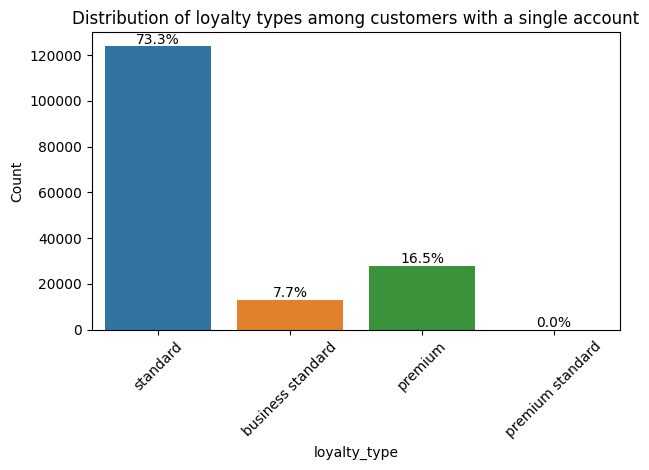

In [ ]:
custom_order = ['standard', 'business standard', 'premium', 'premium standard']
# Create the countplot  (job type abbiamo pochissimi dati. Porta ad un'analisi)
ax =sns.countplot(x='loyalty_type', data=one_customer_id, order=custom_order)

# Calculate percentage for each category
total_entries = len(one_customer_id)
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_height() / total_entries)
    ax.annotate(percentage, (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), textcoords='offset points')

# Customize the plot if needed
plt.xlabel('loyalty_type')
plt.ylabel('Count')
plt.title('Distribution of loyalty types among customers with a single account')
plt.xticks(rotation=45)

# Display the plot
plt.tight_layout()
plt.show()

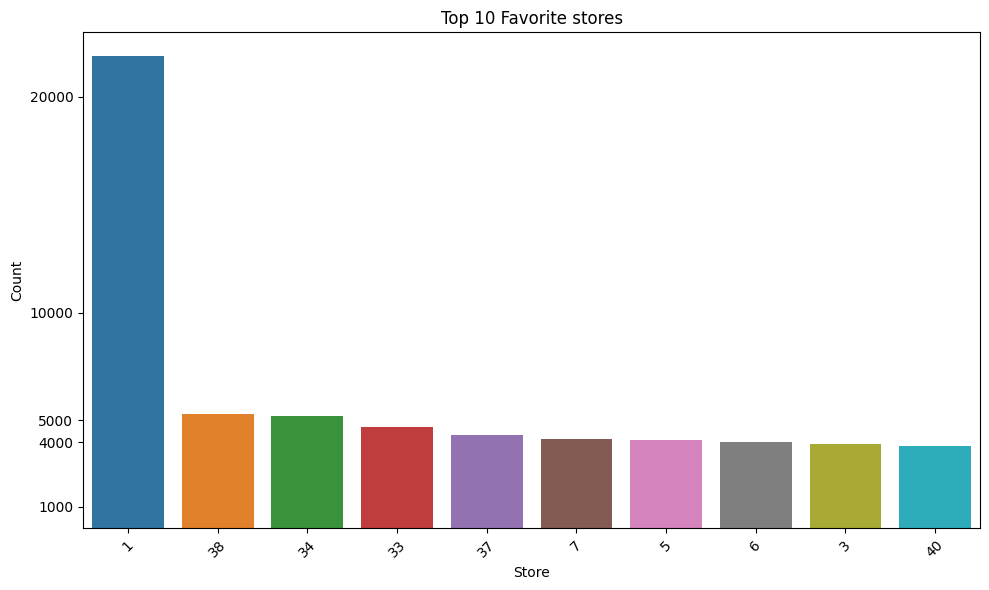

In [ ]:
one_favorite_store = tbl_customer_accounts.groupby('favorite_store', as_index=False)['account_id'].count().sort_values(by='account_id', ascending=False).head(10)
# Create the countplot
plt.figure(figsize=(10, 6))  # Adjust the figure size if needed
sns.barplot(x='favorite_store', y='account_id', data=one_favorite_store, order=one_favorite_store['favorite_store'])

# Customize the plot
plt.xlabel('Store')
plt.ylabel('Count')
plt.title('Top 10 Favorite stores')
plt.xticks(rotation=45)
additional_yticks = [ 1000, 4000, 20000,  5000, 10000]
plt.gca().set_yticks(additional_yticks)
# Display the plot
plt.tight_layout()
plt.show()


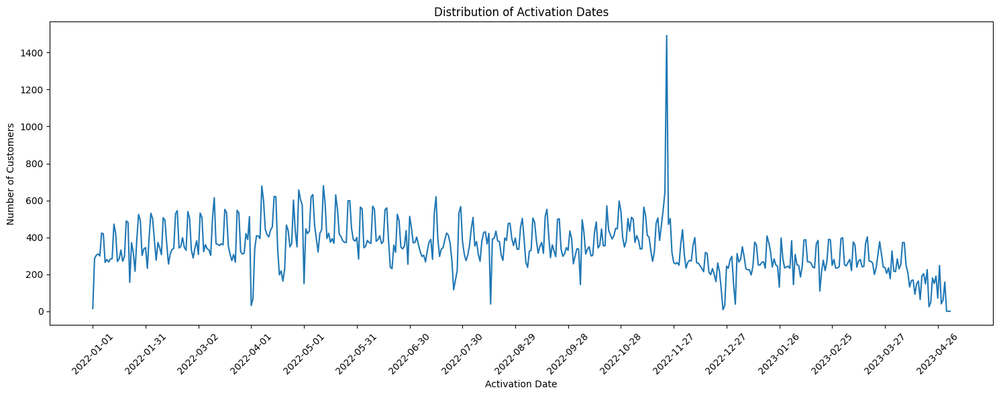

In [ ]:
# Calculate the distribution of activation dates
one_activation_date = one_customer_id.pivot_table(index='activation_date', values='customer_id', aggfunc='count')
y = one_activation_date['customer_id']

plt.figure(figsize=(15, 6))
ax = y.plot()
# Manually set x-axis tick positions
tick_positions = range(0, len(one_activation_date.index), 30)  # Adjust the step size as needed
plt.xticks(tick_positions, one_activation_date.index[tick_positions], rotation=45)
plt.xlabel('Activation Date')
plt.ylabel('Number of Customers')
plt.title('Distribution of Activation Dates')
plt.tight_layout()
plt.show()

## Customer with multiple account

In [ ]:
# 302 unique customer_id have associated to more than one customer_id. Of these 54 have different favorite store
more_customer_id= tbl_customer_accounts[tbl_customer_accounts['size_customer_id'] > 1].sort_values(by= 'loyalty_type', ascending= True)
more_customer_id['loyalty_type'].value_counts()

#favorite_store_counts = more_customer_id.groupby('customer_id')['favorite_store'].nunique()
#favorite_store_counts[favorite_store_counts > 1].count()

standard             324
premium              199
business standard     58
business premium      31
Name: loyalty_type, dtype: int64

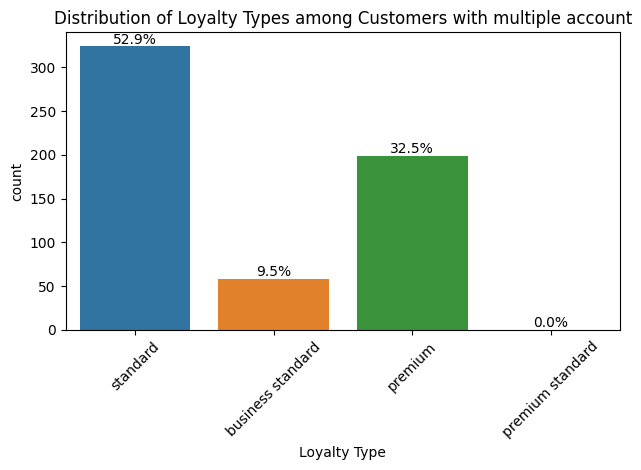

In [ ]:
# Create the countplot with custom order
ax = sns.countplot(x='loyalty_type', data=more_customer_id, order=custom_order)

# Calculate percentage for each category
total_entries = len(more_customer_id)
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_height() / total_entries)
    ax.annotate(percentage, (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5), textcoords='offset points')

# Customize the plot
plt.xlabel('Loyalty Type')
plt.ylabel('count')
plt.title('Distribution of Loyalty Types among Customers with multiple account')
plt.xticks(rotation=45)

# Display the plot
plt.tight_layout()
plt.show()

In [ ]:
# Group by 'customer_id' and count unique 'activation_date' values
customer_activation_counts = more_customer_id.groupby('customer_id')['activation_date'].nunique()
# Filter 'customer_id' with multiple different 'activation_date' values
filtered_customer_ids = customer_activation_counts[customer_activation_counts > 1].index

# Filter the original DataFrame based on the filtered 'customer_id' values
pd.set_option('display.max_rows', None)
filtered_data = more_customer_id[more_customer_id['customer_id'].isin(filtered_customer_ids)].sort_values(by= 'customer_id')
# Group by 'customer_id' and aggregate 'loyalty_type' values
aggregated_loyalty = filtered_data.groupby('customer_id')['loyalty_type'].agg(lambda x: ' -> '.join(x))
filtered_data['direction_loyalty'] = filtered_data['customer_id'].map(aggregated_loyalty)

filtered_data['direction_loyalty'].value_counts()

#we keep only the customer with different loyalty type
values = ['premium -> standard', 'standard -> premium ', 'business standard -> business premium', 'business premium -> business standard', 'standard -> standard -> premium', 'business standard -> premium']
filtered_data = filtered_data[filtered_data['direction_loyalty'].isin(values)]

filtered_data['direction_loyalty'].value_counts()
#44 customer_id have the same favorite store, while 12 have different favorite_store

premium -> standard                      70
business standard -> business premium    10
business premium -> business standard     4
standard -> standard -> premium           3
business standard -> premium              2
Name: direction_loyalty, dtype: int64

## More graphs about customers

In [ ]:
dataset = pd.merge(tbl_customers, tbl_addresses, on='address_id', how='left' ) #3.815.922
dataset = pd.merge(dataset, tbl_customer_accounts, on='customer_id', how='left' )
dataset= dataset.loc[:, ~dataset.columns.isin(['Unnamed: 0_x','birthdate','email_provider','flag_phone_provided', 'flag_privacy','genders','Unnamed: 0_y','district','Unnamed: 0','loyatlty_status','loyalty_code', 'activation_date_days','job_type'])]

In [ ]:
oks = dataset[dataset['region'] != '0']
favorite_store_counts = oks.groupby('favorite_store',as_index=False)['customer_id'].count().sort_values(by='customer_id', ascending=False ).head(10)
favorite_store_counts['customer_id'].describe()


count       10.00000
mean      4958.40000
std       4172.24121
min       3185.00000
25%       3359.50000
50%       3500.00000
75%       4201.75000
max      16772.00000
Name: customer_id, dtype: float64

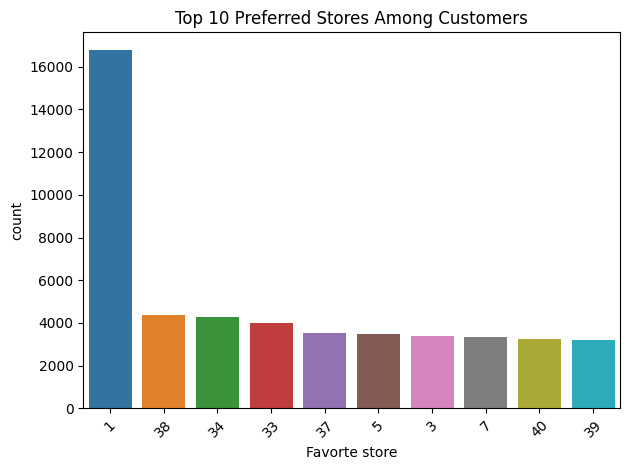

In [ ]:
custom_order= [1, 38, 34, 33, 37, 5, 3, 7, 40, 39]
favorite_store_counts = oks.groupby('favorite_store',as_index=False)['customer_id'].count().sort_values(by='customer_id', ascending=False ).head(10)

sns.barplot(x='favorite_store', y='customer_id', data=favorite_store_counts,order=custom_order )
# Customize the plot
plt.xlabel('Favorte store')
plt.ylabel('count')
plt.title('Top 10 Preferred Stores Among Customers')
plt.xticks(rotation=45)

# Display the plot
plt.tight_layout()
plt.show()

In [ ]:
#dove riesodono i clienti dello store più preferito dai customers?
one_store= oks[oks['favorite_store']== 1]
one_store['region'].value_counts()


LOMBARDIA                4238
LAZIO                    2461
VENETO                   1431
PIEMONTE                 1381
CAMPANIA                 1318
EMILIA ROMAGNA           1112
SICILIA                   930
TOSCANA                   837
PUGLIA                    781
LIGURIA                   502
FRIULI VENEZIA GIULIA     322
ABRUZZO                   312
UMBRIA                    224
MARCHE                    168
CALABRIA                  145
TRENTINO ALTO ADIGE        99
SARDEGNA                   87
BASILICATA                 82
MOLISE                     44
VALLE D'AOSTA              32
ESTERO                      2
Name: region, dtype: int64

In [ ]:
# ho deciso di non usare nunique perche alcuni customer avevano centri commerciali differenti in base all'account_id
#pd.set_option('display.max_rows', None)
ok = dataset[dataset['region'] != '0']
ok = dataset.pivot_table(index=['favorite_store', 'region'], values='customer_id', aggfunc='count').reset_index()


In [ ]:
ok['customer_id_count'] = ok.groupby('favorite_store')['customer_id'].transform('sum')
# Calculate the average of customer_ids for each favorite_store and store in a new column
ok['avarage_customer_id'] = ok.groupby('favorite_store')['customer_id'].transform('mean')

In [ ]:
# Find the index of the row with the maximum customer_id for each favorite_store
max_customer_id_indices = ok.groupby('favorite_store')['customer_id'].idxmax()

# Extract the corresponding rows with the maximum customer_id indices
result = ok.loc[max_customer_id_indices, ['favorite_store', 'region', 'customer_id']]

# Now we count the region
result['region'].value_counts()
results = result.groupby('region', as_index=False).agg(count= ('region', 'size'))

#count the customer_id for each region and merge with results dataset
okt = dataset[dataset['region'] != '0']
okt= okt.groupby('region', as_index= False).agg(count_id= ('customer_id', 'size'))
results= pd.merge(results, okt, on= 'region')

In [ ]:
results

,region,count,count_id
0,ABRUZZO,1,2820
1,CAMPANIA,3,11552
2,EMILIA ROMAGNA,4,9003
3,FRIULI VENEZIA GIULIA,1,2254
4,LAZIO,6,19281
5,LIGURIA,1,3639
6,LOMBARDIA,16,39479
7,PIEMONTE,3,10155
8,PUGLIA,3,7953
9,SICILIA,3,9701


For 16 stores the customers with this store as the most favoured are from the region of Lombardy

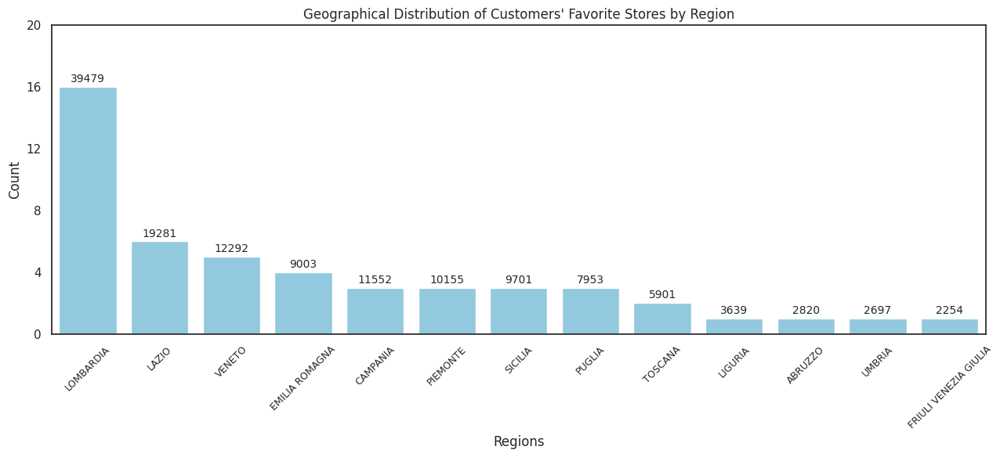

In [ ]:
# Find the index of the row with the maximum customer_id for each favorite_store
max_customer_id_indices = ok.groupby('favorite_store')['customer_id'].idxmax()

# Extract the corresponding rows with the maximum customer_id indices
result = ok.loc[max_customer_id_indices, ['favorite_store', 'region', 'customer_id']]

# Now we count the region
result['region'].value_counts()
results = result.groupby('region', as_index=False).agg(count= ('region', 'size'))

#count the customer_id for each region and merge with results dataset
okt = dataset[dataset['region'] != '0']
okt= okt.groupby('region', as_index= False).agg(count_id= ('customer_id', 'size'))
results= pd.merge(results, okt, on= 'region')

# Sort the DataFrame based on the order list
orders = ['LOMBARDIA' ,'LAZIO',  'VENETO' , 'EMILIA ROMAGNA', 'CAMPANIA','PIEMONTE','SICILIA', 'PUGLIA', 'TOSCANA', 'LIGURIA', 'ABRUZZO', 'UMBRIA', 'FRIULI VENEZIA GIULIA' ]
results= results.set_index('region').reindex(orders).reset_index()
# Set up Seaborn style
sns.set(style="white")

# Create the bar plot
plt.figure(figsize=(13, 6))
ax = sns.barplot(x="region", y="count", data=results, color='skyblue')
plt.xticks(rotation=45, fontsize= 9)
plt.yticks(range(0, 21, 4))
plt.xlabel("Regions")
plt.ylabel("Count")
plt.title("Geographical Distribution of Customers' Favorite Stores by Region")

# Adding count_id values above each bar
for index, row in results.iterrows():
    ax.text(index, row["count"] + 0.3, str(row["count_id"]), ha='center', fontsize= 10)

plt.tight_layout()
plt.show()

#la distribuzione per age_group è sempre la stessa per la maggior parte dei negozi

In [ ]:
result = ok.sort_values(by=['favorite_store', 'customer_id'], ascending=[True, False])

# Usa agg('first') per ottenere la prima riga per ogni "favorite store"
result = result.groupby('favorite_store').agg('first').reset_index()
result

,favorite_store,region,customer_id,customer_id_count,avarage_customer_id
0,1,LOMBARDIA,4238,16528,751.272727
1,2,PIEMONTE,2757,2833,188.866667
2,3,CAMPANIA,3211,3315,174.473684
3,4,FRIULI VENEZIA GIULIA,1834,1908,136.285714
4,5,VENETO,2974,3420,213.750000
5,6,SICILIA,3084,3132,184.235294
6,7,SICILIA,3281,3325,255.769231
7,8,LOMBARDIA,1613,1643,149.363636
8,9,UMBRIA,2388,2706,169.125000
9,10,LOMBARDIA,2365,2444,128.631579


## Insights into Shared Account IDs

<ipython-input-62-9ea7cb8801c0>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  okk['size_account_id']=okk.groupby('account_id', as_index= False)['account_id'].transform('size')


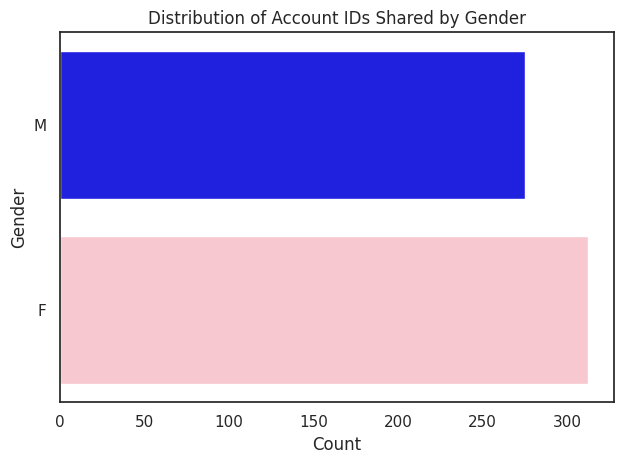

In [ ]:
# Do the individuals who share the same account come from the same region?
okk = dataset[dataset['region'] != '0']
okk['size_account_id']=okk.groupby('account_id', as_index= False)['account_id'].transform('size')
okk= okk[okk['size_account_id'] > 1]

gender_colors = {'F': 'pink', 'M': 'blue'}
# Create the horizontal countplot
sns.countplot(y='gender', data=okk, orient='h',palette=gender_colors)

# Customize the plot if needed
plt.xlabel('Count')
plt.ylabel('Gender')
plt.title('Distribution of Account IDs Shared by Gender')
plt.xticks(rotation=0)  # No rotation needed for horizontal bars
# Display the plot
plt.tight_layout()
plt.show()


#grouped = okk.groupby('account_id')['region'].transform('nunique') > 1
#filtered_data =  okk[grouped]
#There are 1,463,020 shared accounts (20.50% of all accounts), and only one account is shared by two individuals from different regions (Campania and Lombardy)



In [ ]:
# What type of subscription plan is being shared?"
unique_account_ids = okk['account_id'].unique()
okk[okk['account_id'].isin(unique_account_ids)]['loyalty_type'].value_counts()

premium              315
standard             228
business standard     24
business premium      20
Name: loyalty_type, dtype: int64

In [ ]:
#In which region are the customers who share the accounts located
okk.groupby('region')['customer_id'].count().sort_values(ascending=False)

region
LOMBARDIA                153
LAZIO                     80
PIEMONTE                  62
SICILIA                   54
TOSCANA                   54
EMILIA ROMAGNA            44
VENETO                    38
PUGLIA                    24
UMBRIA                    20
CAMPANIA                  18
LIGURIA                   12
FRIULI VENEZIA GIULIA     10
TRENTINO ALTO ADIGE        4
ABRUZZO                    2
SARDEGNA                   2
CALABRIA                   1
Name: customer_id, dtype: int64

In [ ]:
#To which age group do customers, with varying ages yet sharing the same account, belong?
grouped = okk.groupby('account_id')['age_group'].transform('nunique') > 1
filtered_data = okk[grouped].sort_values(by='account_id')
filtered_data
# Group by 'account_id' and aggregate unique 'age_group' values
aggregated_age_band = filtered_data.groupby('account_id')['age_group'].unique().apply(list)
aggregated_age_band.value_counts()

[46-55, 36-45]           22
[36-45, 46-55]           21
[56-65, 36-45]           20
[36-45, 26-35]           19
[26-35, 36-45]           16
[36-45, 56-65]           14
[46-55, 56-65]            9
[66-75, 36-45]            7
[36-45, 66-75]            6
[46-55, 26-35]            5
[66-75, 46-55]            4
[56-65, 26-35]            3
[66-75, 26-35]            2
[46-55, 66-75]            2
[18-25, 36-45]            2
[76-85, 36-45]            1
[56-65, 46-55]            1
[26-35, 66-75]            1
[76-85, 56-65]            1
[36-45, 76-85]            1
[56-65, 66-75]            1
[26-35, 36-45, 46-55]     1
Name: age_group, dtype: int64

#CSV File: "tbl_customer_reviews"




*  **review_id**: Identify the review(key)
*  **customer_id**: Identify the customer who made the review (foreign key)
*  **review_text**: Review full text






In [ ]:
# Extract file: tbl_customer_review
t0 = time()
with zipfile.ZipFile(source_path, 'r') as zip:
    zip.extract('tbl_customer_reviews.csv')
print("File extraction completed in %0.3f seconds" % (time() - t0))

File extraction completed in 3.652 seconds


In [ ]:
# File path of the extracted 'tbl_customers.csv' file #8,98  26,66 64,18
csv_file_path = "tbl_customer_reviews.csv"
tbl_customer_reviews = pd.read_csv(csv_file_path)

In [ ]:
#sentiment_mapping = {'positive': 2, 'neutral': 1, 'negative': 0}
tbl_customer_reviews.head(50)

,Unnamed: 0,review_id,customer_id,review_text,review_text_cleaned,sentiment_of_review
0,0,1,814256,I have bought several of the Vitality canned d...,bought several vitality canned dog food produc...,2
1,1,2,457475,Product arrived labeled as Jumbo Salted Peanut...,product arrived labeled jumbo salted peanutsth...,1
2,2,3,104045,This is a confection that has been around a fe...,confection around centuries light pillowy citr...,2
3,3,4,603662,If you are looking for the secret ingredient i...,looking secret ingredient robitussin believe f...,1
4,4,5,739314,Great taffy at a great price. There was a wid...,great taffy great price wide assortment yummy ...,2
5,5,6,681946,I got a wild hair for taffy and ordered this f...,got wild hair taffy ordered five pound bag taf...,1
6,6,7,464029,This saltwater taffy had great flavors and was...,saltwater taffy great flavors soft chewy candy...,2
7,7,9,662511,Right now I'm mostly just sprouting this so my...,right im mostly sprouting cats eat grass love ...,2
8,8,10,332377,This is a very healthy dog food. Good for thei...,healthy dog food good digestion also good smal...,2
9,9,13,251753,My cats have been happily eating Felidae Plati...,cats happily eating felidae platinum two years...,2


In [ ]:
tbl_customer_reviews= tbl_customer_reviews.loc[:, ~tbl_customer_reviews.columns.isin(['Unnamed: 0','review_text_cleaned'])]

In [ ]:
import string
from wordcloud import WordCloud

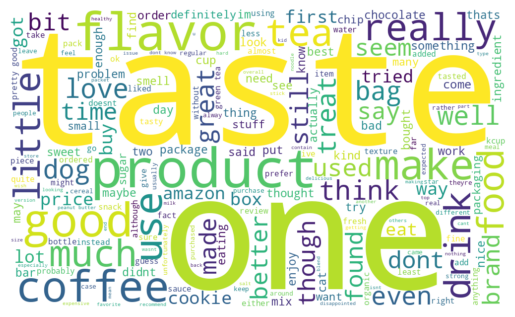

In [ ]:
# Filter rows where the sentiment_label is equal to 'neutral'
neutral_reviews = tbl_customer_reviews.loc[tbl_customer_reviews['sentiment_of_review'] == 1, 'review_text_cleaned']

# Concatenate all neutral reviews into a single string
text = ' '.join(neutral_reviews)

# Create and generate a word cloud image:

wc= WordCloud( background_color= "white",
               mode='RGB',
               max_words=200,
              height=600,
               width= 1000).generate(text)

# Display the generated image:
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

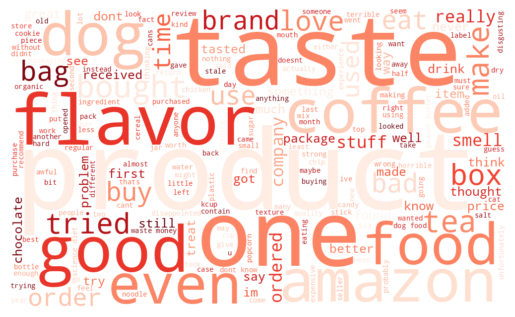

In [ ]:
# Filter rows where the sentiment_label is equal to 'negative'
negative_reviews= tbl_customer_reviews.loc[tbl_customer_reviews['sentiment_of_review'] == 0, 'review_text_cleaned']

# Concatenate all negative reviews into a single string
text = ' '.join(negative_reviews)

# Create and generate a word cloud image:

wc= WordCloud( background_color= "white",
               mode='RGB',
               max_words=200,
              height=600,
               width= 1000,
               colormap='Reds').generate(text)

# Display the generated image:
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

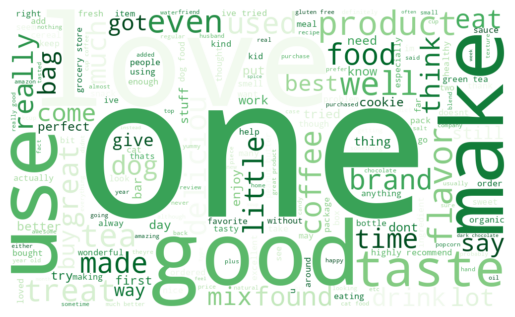

In [ ]:
# Filter rows where the sentiment_label is equal to positive_reviews
positive_reviews= tbl_customer_reviews.loc[tbl_customer_reviews['sentiment_of_review'] == 2, 'review_text_cleaned']

# Concatenate all positive reviews into a single string
text = ' '.join(positive_reviews)

# Create and generate a word cloud image:

wc= WordCloud( background_color= "white",
               mode='RGB',
               max_words=200,
              height=600,
               width= 1000,
               colormap='Greens').generate(text)

# Display the generated image:
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

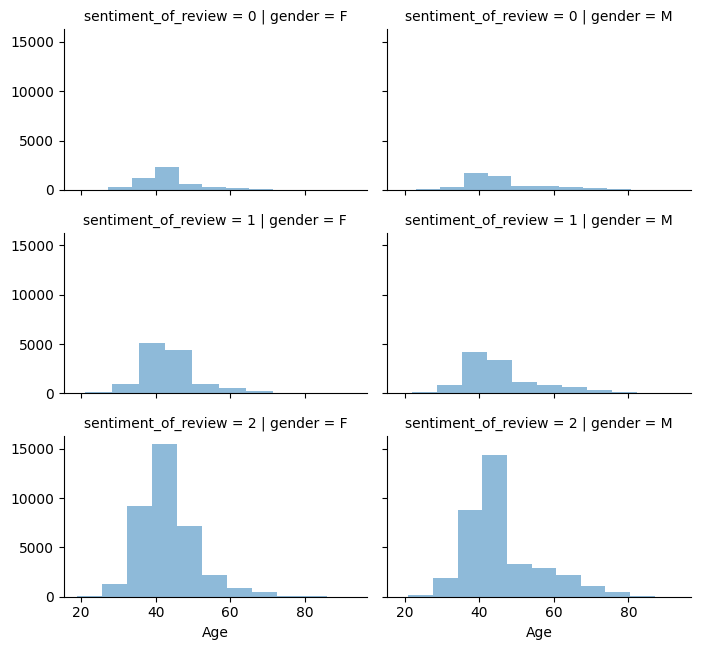

In [ ]:
sentiment_analysis = pd.merge(tbl_customers,tbl_customer_reviews, on= 'customer_id' )
grid = sns.FacetGrid(sentiment_analysis, col='gender', row='sentiment_of_review', height=2.2, aspect=1.6)
grid.map(plt.hist, 'Age', alpha=.5)
grid.add_legend()
# per loyalty type gli standard sono più esigenti

In [ ]:
sentiment_analysis = pd.merge(sentiment_analysis,tbl_customer_accounts, on= 'customer_id' )

store_negative= sentiment_analysis[sentiment_analysis ['sentiment_of_review'] == 0].groupby('favorite_store')['sentiment_of_review'].count().sort_values(ascending=False)
store_negative

favorite_store
1     1089
34     301
38     288
33     264
37     258
20     229
15     228
5      226
7      226
3      216
40     216
6      211
47     207
49     205
39     204
29     195
24     193
26     193
35     192
2      188
25     184
41     184
27     176
48     172
31     170
10     170
17     166
46     166
45     165
44     165
32     165
28     161
21     159
43     159
9      158
12     147
13     145
19     144
14     134
22     129
30     126
4      123
42     117
8      108
36     102
16     102
18      95
11      94
23      87
Name: sentiment_of_review, dtype: int64

Customers who opt for the most favoured shops are also the most likely to give a negative review if they are not satisfied with the purchased item

In [ ]:
store_negative= sentiment_analysis[sentiment_analysis ['sentiment_of_review'] == 0].groupby('region')['sentiment_of_review'].count().sort_values(ascending=False)
store_negative

region
LOMBARDIA                2647
LAZIO                    1310
VENETO                    825
CAMPANIA                  752
SICILIA                   661
PIEMONTE                  649
EMILIA ROMAGNA            605
PUGLIA                    574
TOSCANA                   414
LIGURIA                   265
ABRUZZO                   198
UMBRIA                    166
FRIULI VENEZIA GIULIA     148
MARCHE                     32
CALABRIA                   24
BASILICATA                 23
MOLISE                     15
SARDEGNA                   14
TRENTINO ALTO ADIGE        14
0                          14
VALLE D'AOSTA               4
ESTERO                      2
Name: sentiment_of_review, dtype: int64

# CSV File: "tbl_products"



*   **product_id**: Identify the product (key)
*   **product_class**: Identify the department corresponding to the
product



In [ ]:
# Extract file: tbl_customer_review
t0 = time()
with zipfile.ZipFile(source_path, 'r') as zip:
    zip.extract('tbl_products.csv')
print("File extraction completed in %0.3f seconds" % (time() - t0))

File extraction completed in 0.620 seconds


In [ ]:
# File path of the extracted 'tbl_customers.csv' file
csv_file_path = "tbl_products.csv"
tbl_products = pd.read_csv(csv_file_path)

In [ ]:
tbl_products

,Unnamed: 0,product_id,product_class
0,0,35996051,9
1,1,35980371,14
2,2,31276196,4
3,3,31276224,4
4,4,31456495,4
...,...,...,...
88533,88533,36218763,3
88534,88534,36219624,3
88535,88535,36219631,3
88536,88536,36219694,3


In [ ]:
tbl_products= tbl_products.loc[:, ~tbl_products.columns.isin(['Unnamed: 0'])]

In [ ]:
# Unique products in the set
tbl_products['product_id'].nunique()

88538

In [ ]:
# There are 14 product class and it appears that product classe 12 and 9 offer the widest range of product varieties
tbl_products['product_class'].value_counts().sort_values(ascending=False)

12    13893
9     13325
7      9974
10     9845
3      7326
11     6690
4      5945
13     5283
2      4105
6      3340
5      2528
8      2241
1      2203
14     1840
Name: product_class, dtype: int64

# CSV File: "tbl_orders"



*   **order_id**:identify the transaction (all the products purchased or refund within the
same transaction have the same id)

*  **customer_id**:identify client
(foreign key)

*   **store_id**:identify reference store
(foreign key)

*   **product_id**:identify the purchased or refund item
(foreign key)
*   **direction**: Identify if the product within the order has been
purchased (1) or refunded (-1)


*  **gross_price**: [Euro] gross price = net price – price_reduction
(negative if the product has been refunded)


*  **price_reduction**: [in Euro] price reduction applied
(negative if the product has been refunded)


*  **purchase_datetime**: date and time of the purchase



There are a total of 371,804 orders in the dataset. These orders consist of a range of 1 to 1,596 products per order, with an average of approximately 2.79 products per order. Among these orders, 295,318 orders have at most 3 products, while 76,486 orders have 4 or more products. Notably, all products within each order were purchased and finalized at the same 'purchase_datetime.'

i prodotti dello stesso ordine hanno direction identica. Ci sono 104 ordini con direction (1) ma con alcuni prodotti che presentano gross_price positivo o negativo: hanno tutti price_reduction=0. mentre c'e soltanto un ordine (5037a10e3566408eaa4b089a5ed6a419) con direction (-1) e gross price positivo.

Il net price è calcolato come gross_price + price reduction solamente per quei prodotti con gross_price e price_reduction positiva. Per tutte le altre casistiche è stato aggiunto un valore NaN. In questo modo, il calcolo successivo della colonna percentual discount, customer_total_spent e tot_purchases sono consistenti.


Se il verso non è consistente, il calcolo è sbagliato.
 nel calcolo se hanno price_reduction negativa, allora le colonqueine net_price e pct% riportano nan values.





In [ ]:
# Extract file: tbl_orders
t0 = time()
with zipfile.ZipFile(source_path, 'r') as zip:
    zip.extract('tbl_orders.csv')
print("File extraction completed in %0.3f seconds" % (time() - t0))

File extraction completed in 2.365 seconds


In [ ]:
# File path of the extracted 'tbl_customers.csv' file
csv_file_path = "tbl_orders.csv"
tbl_orders = pd.read_csv(csv_file_path, parse_dates=["purchase_date"])

In [ ]:
tbl_orders

,Unnamed: 0,order_id,customer_id,store_id,product_id,direction,gross_price,price_reduction,purchase_datetime,purchase_date,...,day_of_week,net_price,pct_discount(%),gross_price_revised,customer_total_spent,customer_total_purchases,last_purchase_date,days_from_last_purchase,last_day_tot_amount,last_day_num_products
0,0,8fe4346b53d0c781b275a614175804de,23,49,35551922,1,125.40,0.0,2022-10-04 18:28:51,2022-10-04,...,tuesday,125.40,0.0,125.40,483.13,36,2023-02-20,69.0,28.62,5.0
1,1,8fe4346b53d0c781b275a614175804de,23,49,30344384,1,8.30,0.0,2022-10-04 18:28:51,2022-10-04,...,tuesday,8.30,0.0,8.30,483.13,36,2023-02-20,69.0,28.62,5.0
2,2,8fe4346b53d0c781b275a614175804de,23,49,33794292,1,1.99,0.0,2022-10-04 18:28:51,2022-10-04,...,tuesday,1.99,0.0,1.99,483.13,36,2023-02-20,69.0,28.62,5.0
3,3,8fe4346b53d0c781b275a614175804de,23,49,33795776,1,5.10,0.0,2022-10-04 18:28:51,2022-10-04,...,tuesday,5.10,0.0,5.10,483.13,36,2023-02-20,69.0,28.62,5.0
4,4,8fe4346b53d0c781b275a614175804de,23,49,36235381,1,76.05,0.0,2022-10-04 18:28:51,2022-10-04,...,tuesday,76.05,0.0,76.05,483.13,36,2023-02-20,69.0,28.62,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
916995,916995,697c0078b69d9f8c119d8dd9a7952019,934581,29,35508942,1,33.60,0.0,2023-04-30 19:35:53,2023-04-30,...,sunday,33.60,0.0,33.60,33.60,1,2023-04-30,0.0,33.60,1.0
916996,916996,86c9c4fdb8829e2ab90a86a357763419,934620,44,36237691,1,11.99,0.0,2023-04-30 19:19:55,2023-04-30,...,sunday,11.99,0.0,11.99,21.98,2,2023-04-30,0.0,21.98,2.0
916997,916997,86c9c4fdb8829e2ab90a86a357763419,934620,44,81259479,1,9.99,0.0,2023-04-30 19:19:55,2023-04-30,...,sunday,9.99,0.0,9.99,21.98,2,2023-04-30,0.0,21.98,2.0
916998,916998,86f8ca9e4008249e5e0acc5ff23e2284,934660,46,34067775,1,1.90,0.0,2023-04-30 19:32:17,2023-04-30,...,sunday,1.90,0.0,1.90,1.90,1,2023-04-30,0.0,1.90,1.0


In [ ]:
# how many days have passed on average since the last purchase?(Timestamp('2023-04-30') di riferimento)
tbl_orders['last_day_num_products'].mean()


3.206874527460871

In [ ]:
tbl_orders.columns

Index(['Unnamed: 0', 'order_id', 'customer_id', 'store_id', 'product_id',
       'direction', 'gross_price', 'price_reduction', 'purchase_datetime',
       'purchase_date', 'purchase_time', 'Week', 'Day', 'day_of_week',
       'net_price', 'pct_discount(%)', 'gross_price_revised',
       'customer_total_spent', 'customer_total_purchases',
       'last_purchase_date', 'days_from_last_purchase', 'last_day_tot_amount',
       'last_day_num_products'],
      dtype='object')

In [ ]:
tbl_orders = tbl_orders.loc[:, ~tbl_orders.columns.isin(['Unnamed: 0','price_reduction','purchase_datetime'])]

In [ ]:
df00= tbl_orders[['order_id','customer_id','product_id','direction','gross_price_revised','purchase_date']]
df00=df00[df00['direction']==1]
df00

,order_id,customer_id,product_id,direction,gross_price_revised,purchase_date
0,8fe4346b53d0c781b275a614175804de,23,35551922,1,125.40,2022-10-04
1,8fe4346b53d0c781b275a614175804de,23,30344384,1,8.30,2022-10-04
2,8fe4346b53d0c781b275a614175804de,23,33794292,1,1.99,2022-10-04
3,8fe4346b53d0c781b275a614175804de,23,33795776,1,5.10,2022-10-04
4,8fe4346b53d0c781b275a614175804de,23,36235381,1,76.05,2022-10-04
...,...,...,...,...,...,...
916995,697c0078b69d9f8c119d8dd9a7952019,934581,35508942,1,33.60,2023-04-30
916996,86c9c4fdb8829e2ab90a86a357763419,934620,36237691,1,11.99,2023-04-30
916997,86c9c4fdb8829e2ab90a86a357763419,934620,81259479,1,9.99,2023-04-30
916998,86f8ca9e4008249e5e0acc5ff23e2284,934660,34067775,1,1.90,2023-04-30


In [ ]:
df00['tot_spent_day']= df00.groupby(['customer_id','purchase_date'])['gross_price_revised'].transform('sum')
df00.drop_duplicates(subset=['customer_id', 'purchase_date'], keep='first', inplace=True)

In [ ]:
df00['count_orders']= df00.groupby(['customer_id','purchase_date'])['order_id'].transform('count')

In [ ]:
df00

,order_id,customer_id,product_id,direction,gross_price_revised,purchase_date,tot_spent_day,count_orders
0,8fe4346b53d0c781b275a614175804de,23,35551922,1,125.40,2022-10-04,216.84,1
5,c2ae3673970490406925dcd3f8a4d486,23,35002296,1,1.70,2022-10-31,75.33,1
14,c3d616db59bbc52a92b1f81901dfdd75,23,34416235,1,13.90,2022-11-17,29.03,1
17,a55b0fc1b02134f9b5fa4378a74e2e63,23,35165452,1,7.47,2022-11-29,7.47,1
18,813f7eae0fffc3cbf0860194efb04084,23,34663916,1,7.99,2022-12-06,66.47,1
...,...,...,...,...,...,...,...,...
916990,b577e0cb3254ef8e4965ebc0643c90af,934484,33817091,1,0.50,2023-04-30,39.10,1
916995,697c0078b69d9f8c119d8dd9a7952019,934581,35508942,1,33.60,2023-04-30,33.60,1
916996,86c9c4fdb8829e2ab90a86a357763419,934620,36237691,1,11.99,2023-04-30,21.98,1
916998,86f8ca9e4008249e5e0acc5ff23e2284,934660,34067775,1,1.90,2023-04-30,1.90,1


In [ ]:
df01= df00[['purchase_date','count_orders']].set_index('purchase_date')
fig = px.histogram(df01, x=df01.index, y='count_orders', title='Total Orders per Day Over Time')
fig.show()

In [ ]:
df01= df00[['purchase_date','tot_spent_day']].set_index('purchase_date')
fig = px.histogram(df01, x=df01.index, y='tot_spent_day', title='Total Spent per Day Over Time', )
fig.show()

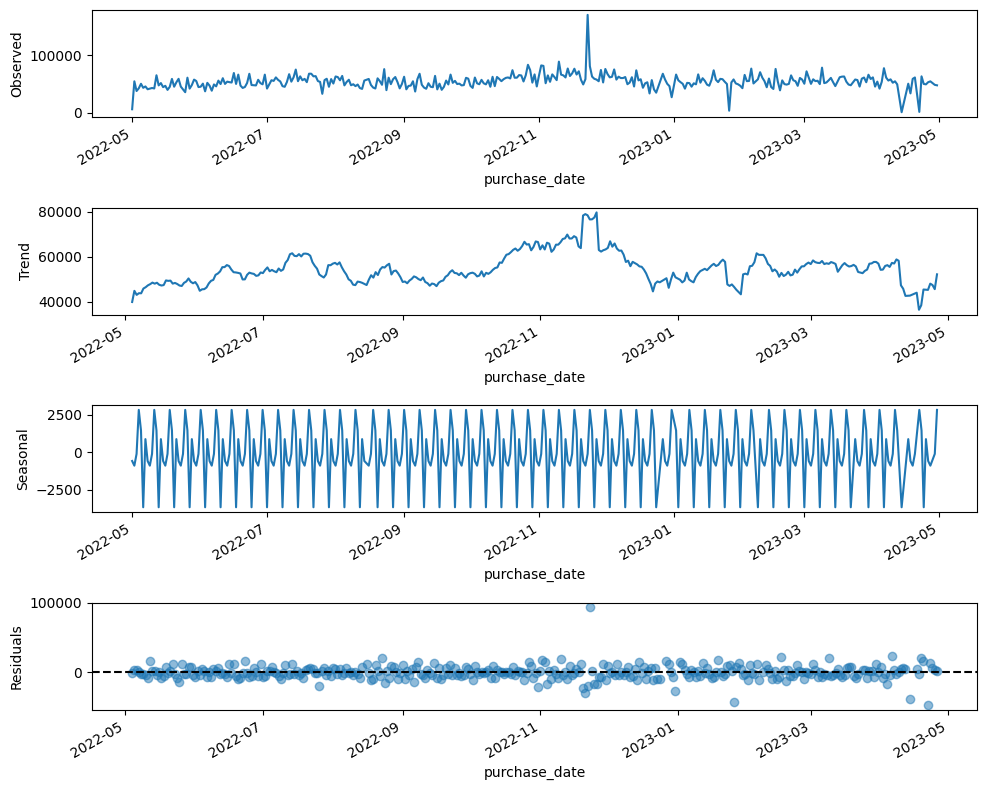

In [ ]:
# stagionalità sales
# Set 'purchase_date' as the index
purchase_dates = tbl_orders.groupby('purchase_date')['gross_price_revised'].sum().reset_index().set_index('purchase_date')
# Perform seasonal decomposition with a period of 7 (weekly seasonality)
result = seasonal_decompose(purchase_dates, model='additive',period= 7 )

# assuming an additive model, we plote 4 resulting series
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(10, 8))
result.observed.plot(ax=ax1)
ax1.set_ylabel('Observed')
result.trend.plot(ax=ax2)
ax2.set_ylabel('Trend')
result.seasonal.plot(ax=ax3)
ax3.set_ylabel('Seasonal')
result.resid.plot(ax=ax4, marker='o',  linestyle='', alpha=0.5)
plt.axhline(0, color='black', linestyle='--')
ax4.set_ylabel('Residuals')
plt.tight_layout()
plt.show()

<ipython-input-16-66565c5892d8>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['purchase_date'] = pd.to_datetime(df['purchase_date'])


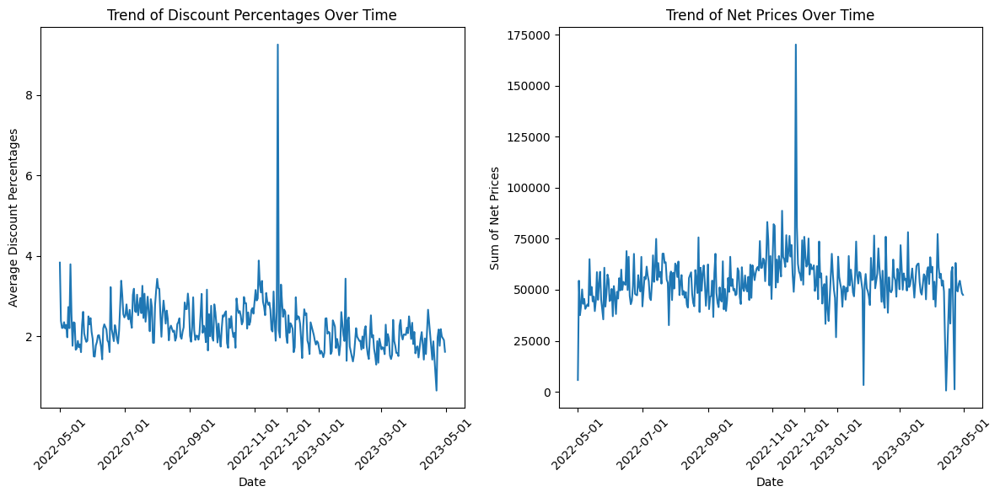

In [ ]:
df = tbl_orders[['order_id', 'customer_id', 'gross_price_revised', 'pct_discount(%)', 'purchase_date', 'purchase_time']]
df['purchase_date'] = pd.to_datetime(df['purchase_date'])

# Group by date and calculate the average discount percentages
discount_avg = df.groupby('purchase_date')['pct_discount(%)'].mean()

# Group by date and calculate the sum of net prices
net_price_sum = df.groupby('purchase_date')['gross_price_revised'].sum()

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)  # First subplot for discount percentages
plt.plot(discount_avg.index, discount_avg.values, linestyle='-')
plt.title('Trend of Discount Percentages Over Time')
plt.xlabel('Date')
plt.ylabel('Average Discount Percentages')

# Add "December 2022" as a tick on the x-axis in the first subplot
extra_ticks = [mdates.date2num(pd.Timestamp('2022-12-01'))]
plt.xticks(list(plt.xticks()[0]) + extra_ticks, rotation=45)  # Add the tick to the first subplot

plt.subplot(1, 2, 2)  # Second subplot for net prices
plt.plot(net_price_sum.index, net_price_sum.values, linestyle='-')
plt.title('Trend of Net Prices Over Time')
plt.xlabel('Date')
plt.ylabel('Sum of Net Prices')

# Add "December 2022" as a tick on the x-axis in the second subplot
plt.xticks(list(plt.xticks()[0]) + extra_ticks, rotation=45)  # Add the tick to the second subplot

plt.tight_layout()
plt.show()

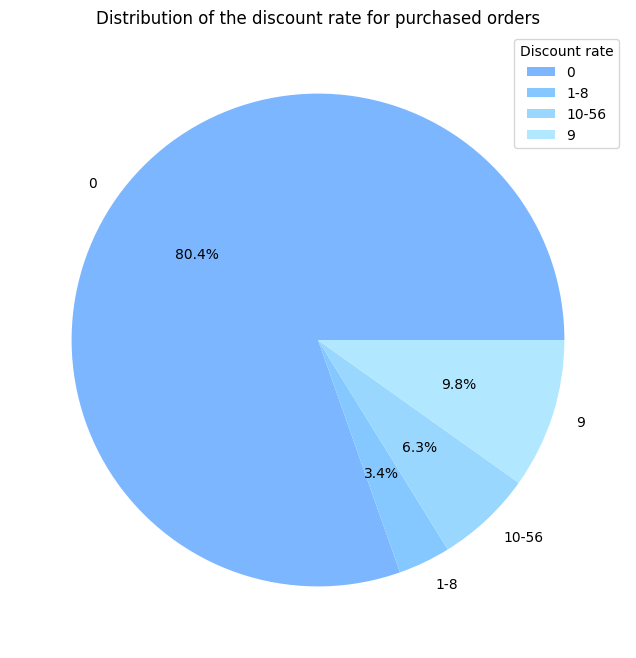

In [ ]:
ok= tbl_orders[['order_id','customer_id',  'net_price','pct_discount(%)' ]]
ok = ok.dropna(subset=['pct_discount(%)'])
ok['pct'] = ok['pct_discount(%)'].astype(int)
oks= ok.groupby('pct', as_index=False).agg(count=('pct', 'count'))
ranges = [(0, 0), (1, 8), (9, 9), (10,56)]
def assign_range(pct):
    for r in ranges:
        if r[0] <= pct <= r[1]:
            return f"{r[0]}-{r[1]}"
    return "Out of Range"

oks['pct_range'] = oks['pct'].apply(assign_range)
oks= oks.groupby('pct_range', as_index=False).agg(count_range=('count', 'sum'))

replace_dict = {'0-0': '0', '9-9': '9'}

oks['pct_range'] = oks['pct_range'].replace(replace_dict)

# Define lighter shades of blue
colors = ['#7cb6ff', '#85c7ff', '#99d7ff', '#b2e8ff', '#ccf0ff', '#e0f5ff', '#f0faff', '#f9fcff']

# Create the pie chart
plt.figure(figsize=(8, 8))
plt.pie(oks['count_range'], labels=oks['pct_range'], autopct='%1.1f%%', colors=colors)
plt.title('Distribution of the discount rate for purchased orders')

# Add a legend
plt.legend(oks['pct_range'], title='Discount rate', loc='best')

# Show the chart
plt.show()

In [ ]:
#which products grossed the most?
pt= tbl_orders.groupby(['product_id']).agg(sales= ('gross_price_revised', 'sum'), avg_discount= ('pct_discount(%)', 'mean')).sort_values(by='sales', ascending= False)
print(pt.head(15))


                sales  avg_discount
product_id                         
48020504    588075.32     10.668048
48011971    574806.96      9.815752
36483013    172847.64      9.228511
48020203    164432.98     11.036343
33883955    158387.76      3.723482
35903252    138153.68      2.657844
35551922    134001.83      2.626834
36658650    129281.48      4.219844
34906410    120270.09      5.051393
48010340    116021.39      9.882698
35984396    112722.48      6.641234
36481214    112349.00      3.020883
35551915    109709.49      3.512915
81250370    108085.69      6.887265
32840766    105350.93      3.244251


In [ ]:
#which store grossed the most?
print(tbl_orders.groupby(['store_id']).agg(sales= ('gross_price_revised', 'sum')).sort_values(by='sales', ascending= False))

              sales
store_id           
33        663503.22
37        649232.83
49        642351.71
38        622606.96
39        603380.72
5         563181.68
20        555062.36
3         553579.24
7         537464.64
41        531111.91
34        511697.45
17        510045.75
26        483742.15
45        470334.54
9         465196.23
28        461388.38
2         460141.04
35        457807.04
21        456880.86
47        443373.23
25        428591.31
6         416352.37
48        391704.40
46        375464.13
10        370509.67
32        344224.92
19        343702.65
4         339395.85
44        330349.01
29        326094.56
27        324301.28
13        319138.70
30        305463.06
14        304728.74
15        302738.09
24        297191.28
16        288860.75
11        285077.53
22        281068.33
18        278301.60
43        274225.86
31        274161.34
42        263087.26
12        261484.49
40        258663.75
23        241670.06
36        192754.69
8         188386.83


In [ ]:
class_prod= pd.merge( tbl_orders, tbl_products, on= 'product_id', how= 'left')
class_prods= class_prod.groupby(['product_class']).agg(sales= ('gross_price_revised', 'sum'), avg_discount= ('pct_discount(%)', 'mean')).sort_values(by='sales', ascending= False)
class_prods

,sales,avg_discount
product_class,,
6,4235471.90,4.228993
7,3546910.43,3.134997
2,3048921.70,5.146225
3,2399729.57,2.013513
13,1424491.40,2.210277
11,1194209.47,1.748592
8,729983.01,2.820187
14,558036.87,1.447066
1,516474.15,2.332141


In [ ]:
class_prod= pd.merge( tbl_orders, tbl_products, on= 'product_id', how= 'left')
class_prod.groupby(['product_class', 'purchase_date'], as_index= False)['gross_price_revised'].sum()

,product_class,purchase_date,gross_price_revised
0,1,2022-05-01,19.77
1,1,2022-05-02,558.43
2,1,2022-05-03,315.47
3,1,2022-05-04,411.51
4,1,2022-05-05,1108.16
...,...,...,...
4942,14,2023-04-25,2877.87
4943,14,2023-04-26,2280.38
4944,14,2023-04-27,2077.98
4945,14,2023-04-29,1615.66


In [ ]:
print(f"Correlation: {class_prods['sales'].corr(class_prods['avg_discount'])}")
print(f"Covariance: {class_prods['sales'].cov(class_prods['avg_discount'])}")

Correlation: 0.6543762985245741
Covariance: 968480.5090183683


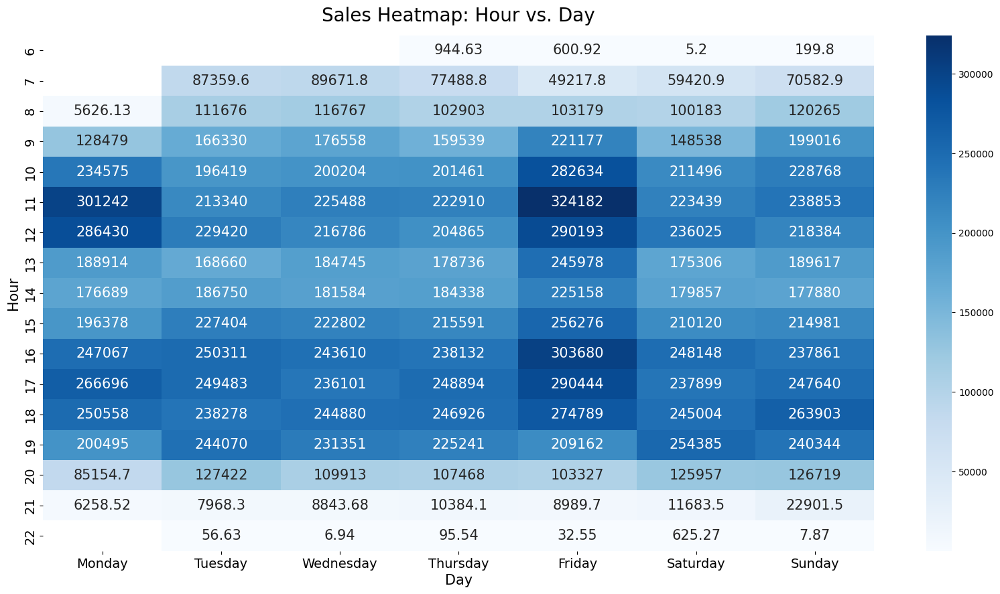

In [ ]:
tbl_orders['purchase_time'] = pd.to_datetime(tbl_orders['purchase_time'])
tbl_orders['hour'] = tbl_orders['purchase_time'].dt.hour
# We create a pivot table named hour_day that summarizes the total sales based on the 'Hour' and 'giorno_settimana'
hour_day = tbl_orders.pivot_table(index='hour', columns='day_of_week',values='gross_price_revised', aggfunc='sum')

# we change the label of the weekday
hour_day.columns= ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# we plot the heat map
plt.figure(figsize=(20, 10))
sns.heatmap(hour_day, cmap='Blues', annot=True, fmt='g', annot_kws={"fontsize": 15}) # g stands for automatically adjust the format
plt.xlabel('Day', fontsize=15)
plt.ylabel('Hour', fontsize=15)
plt.title('Sales Heatmap: Hour vs. Day', fontsize=20, pad=15)
plt.xticks( fontsize=14)
plt.yticks(fontsize=14)

plt.show()
#l'orario di apertura degli sotre è dalle 6 alle 22

In [ ]:
data= pd.merge(tbl_products, tbl_orders, on='product_id' )
data= pd.merge(tbl_customers, data, on='customer_id' )
data= pd.merge(tbl_customer_accounts, data, on='customer_id' )
data = data.loc[:, ~data.columns.isin(['Unnamed: 0_x','job_type','email_provider','Unnamed: 0_y', 'last_purchase_date', 'last_day_tot_amount', 'last_day_num_products',
       'days_from_last_purchase', 'Unnamed: 0','loyatlty_status', 'loyalty_code'])]

<ipython-input-59-ed74bc229f96>:3: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Unnamed: 0_y'} in the result is deprecated and will raise a MergeError in a future version.
  data= pd.merge(tbl_customer_accounts, data, on='customer_id' )


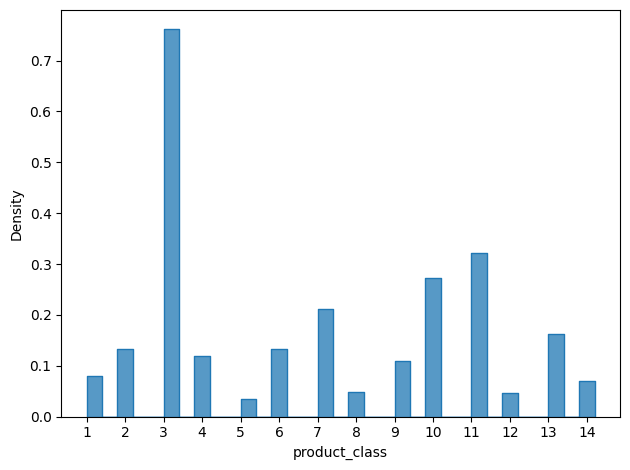

In [ ]:

xtick_positions = range(int(min(data["product_class"])), int(max(data["product_class"])) + 1)
xtick_labels = [str(x) for x in xtick_positions]

sns.histplot(data=data, x="product_class", binwidth=0.4, element="step", stat="density")
plt.xticks(xtick_positions, xtick_labels)
plt.tight_layout()  # To prevent label cutoff

plt.show()


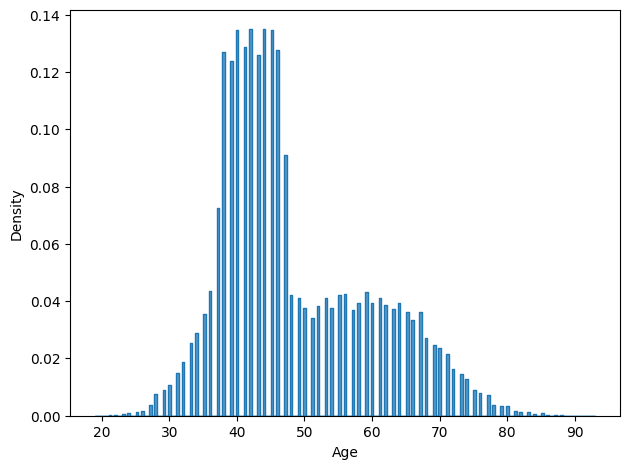

In [ ]:
sns.histplot(data=data, x="Age", binwidth=0.4, element="step", stat="density")
plt.tight_layout()  # To prevent label cutoff
plt.show()

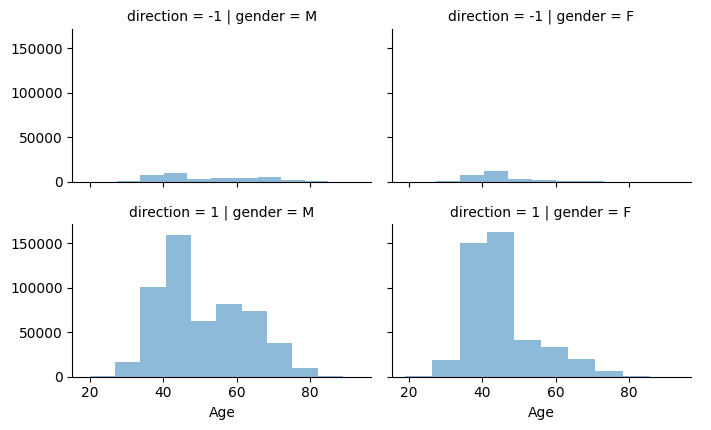

In [ ]:

grid = sns.FacetGrid(data, col='gender', row='direction', height=2.2, aspect=1.6)
grid.map(plt.hist, 'Age', alpha=.5)
grid.add_legend()

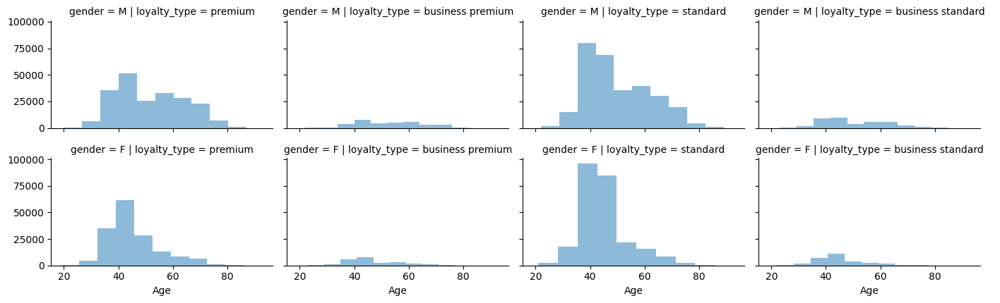

In [ ]:
grid = sns.FacetGrid(data, col='loyalty_type', row='gender', height=2.2, aspect=1.6)
grid.map(plt.hist, 'Age', alpha=.5)
grid.add_legend()

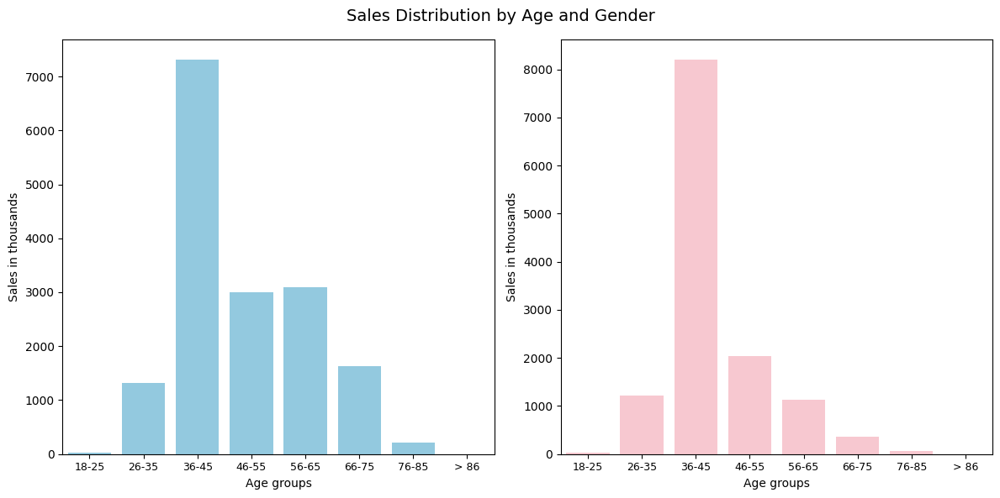

In [ ]:
agegroup_gender= data.pivot_table(index=['age_group','gender' ], values='gross_price_revised', aggfunc='sum').reset_index()
conversion_factor = 0.001
# Convert 'gross_price_revised' column to miles

agegroup_gender['gross_price_revised'] = round(agegroup_gender['gross_price_revised'] * conversion_factor,2)
agegroup_male= agegroup_gender[agegroup_gender['gender'] == 'M']
agegroup_female=agegroup_gender[agegroup_gender['gender'] == 'F']

plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
ax = sns.barplot(x="age_group", y="gross_price_revised", data=agegroup_male, color='skyblue')
plt.xticks( fontsize= 9)

plt.xlabel("Age groups")
plt.ylabel("Sales in thousands")


plt.subplot(1, 2, 2)
ax = sns.barplot(x="age_group", y="gross_price_revised", data=agegroup_female, color='pink')
plt.xticks( fontsize= 9)
plt.xlabel("Age groups")
plt.ylabel("Sales in thousands")
plt.suptitle("Sales Distribution by Age and Gender", fontsize=14)
plt.tight_layout()
plt.show()

In [ ]:
Index(['customer_id', 'account_id', 'favorite_store', 'loyalty_type',
       'activation_date', 'activation_date_days', 'address_id', 'gender',
       'Age', 'age_group', 'product_id', 'product_class', 'order_id',
       'store_id', 'direction', 'gross_price', 'price_reduction',
       'purchase_datetime', 'purchase_date', 'purchase_time', 'Week', 'Day',
       'day_of_week', 'net_price', 'pct_discount(%)', 'tot_amount_spent',
       'tot_purchases'],

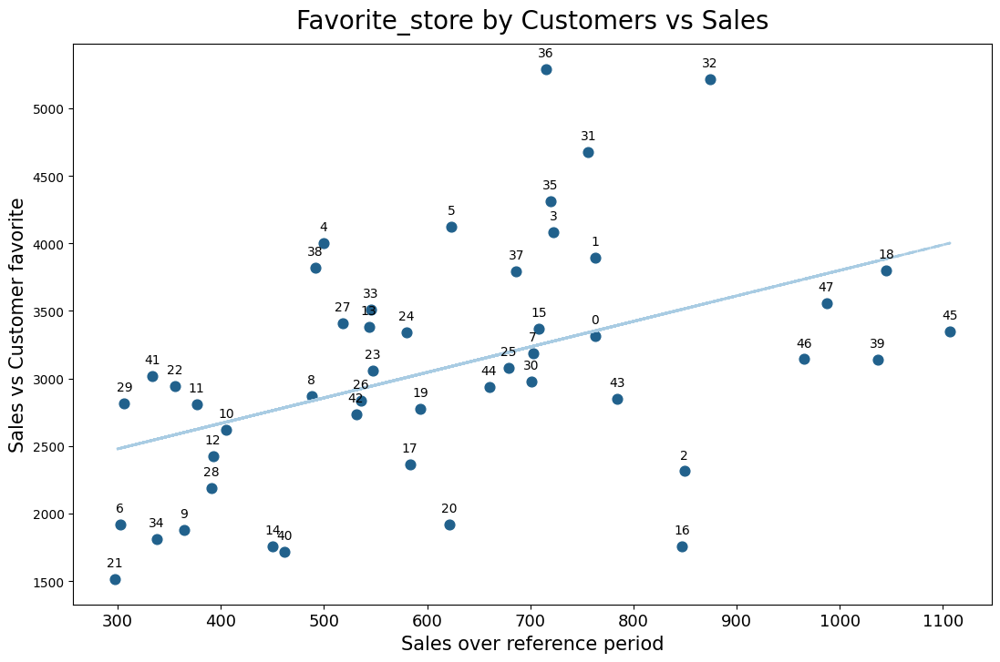

In [ ]:
# c'è una correlazione tra store_favorite e sales
store_id_profitable= tbl_orders.groupby('store_id', as_index=False)['gross_price_revised'].sum().sort_values(by= 'gross_price_revised', ascending=False)
conversion_factor = 0.001
# Convert 'gross_price_revised' column to miles
store_id_profitable['net_price_k'] = round(store_id_profitable['gross_price_revised'] * conversion_factor,2)
# we merge with tbl_customer_accounts
store_id_favorite=tbl_customer_accounts.groupby('favorite_store', as_index=False)['customer_id'].count()
store= pd.merge(store_id_favorite, store_id_profitable, left_on=['favorite_store'], right_on=['store_id'] )

# we plot the graph
n= store['favorite_store'].index

plt.figure(figsize=(13,8))
plt.scatter(store['net_price_k'], store['customer_id'], color='#21618C', s=60)
plt.xlabel('Sales over reference period', fontsize=15)
plt.ylabel('Sales vs Customer favorite', fontsize=15)
plt.title('Favorite_store by Customers vs Sales', fontsize=20, pad=12)
plt.xticks(fontsize=13)

# add label
for i, txt in enumerate(n):
    plt.annotate(txt, (store['net_price_k'][i], store['customer_id'][i]), textcoords="offset points", xytext=(0,10), ha='center')

#find line of best fit
a, b = np.polyfit(store['net_price_k'], store['customer_id'], 1)

# Add dashed line of best fit to plot
plt.plot(store['net_price_k'], a * store['net_price_k'] + b, color='#A9CCE3', linestyle='--', linewidth=2)

plt.show()